In [14]:
!pip install patchify
!pip install -q monai

Defaulting to user installation because normal site-packages is not writeable
^C


In [1]:
!nvidia-smi

Failed to initialize NVML: Unknown Error


In [1]:

import numpy as np
import matplotlib.pyplot as plt
import os
from patchify import patchify  #Only to handle large images
import random
from scipy import ndimage
     

In [29]:
import numpy as np

def get_bounding_box(ground_truth_map):
    """Get a bounding box from a ground truth map
    Args:
        ground_truth_map (np.array): Ground truth map, expected to be 2D or 3D with shape (H, W) or (H, W, C).
    Returns:
        bbox (list): Bounding box coordinates [x_min, y_min, x_max, y_max]"""
    # Check if the ground truth map is not 2D and reduce it to 2D by selecting the first channel
    if ground_truth_map.ndim > 2:
        ground_truth_map = ground_truth_map[:, :, 0]  # Assuming the mask is the same across all channels

    # Check if the ground truth map is empty
    if np.sum(ground_truth_map) == 0:
        return [0, 0, ground_truth_map.shape[1], ground_truth_map.shape[0]]

    # Get bounding box from mask
    y_indices, x_indices = np.where(ground_truth_map > 0)
    x_min, x_max = np.min(x_indices), np.max(x_indices)
    y_min, y_max = np.min(y_indices), np.max(y_indices)

    # Add perturbation to bounding box coordinates
    H, W = ground_truth_map.shape
    x_min = max(0, x_min - np.random.randint(0, 20))
    x_max = min(W, x_max + np.random.randint(0, 20))
    y_min = max(0, y_min - np.random.randint(0, 20))
    y_max = min(H, y_max + np.random.randint(0, 20))
    
    bbox = [x_min, y_min, x_max, y_max]

    return bbox



In [3]:
import os
import numpy as np
from PIL import Image
from datasets import Dataset
from torch.utils.data import Dataset as TorchDataset
from sklearn.model_selection import train_test_split

class WaterDatasetLoader:

    """
    A class used to load and preprocess a dataset of water images and their corresponding annotations.

    ...

    Attributes
    ----------
    dataset_root : str
        The root directory of the dataset
    image_subfolder : str
        The subfolder within the root directory that contains the images
    annotation_subfolder : str
        The subfolder within the root directory that contains the annotations
    image_paths : list
        A list of paths to the images in the dataset
    annotation_paths : list
        A list of paths to the annotations in the dataset

    Methods
    -------
    load_paths():
        Loads the paths of the images and annotations into the respective lists.
    load_and_preprocess_image(image_path, target_size=(256, 256), dtype=np.uint8):
        Loads and preprocesses an image from the given path.
    load_and_preprocess_annotation(annotation_path, target_size=(256, 256), dtype=np.uint8):
        Loads and preprocesses an annotation from the given path.
    create_dataset():
        Creates a dataset from the loaded and preprocessed images and annotations.
    """

    def __init__(self, dataset_root, image_subfolder, annotation_subfolder):
         
        """
        Constructs all the necessary attributes for the WaterDatasetLoader object.

        Parameters
        ----------
            dataset_root : str
                The root directory of the dataset
            image_subfolder : str
                The subfolder within the root directory that contains the images
            annotation_subfolder : str
                The subfolder within the root directory that contains the annotations
        """

        self.dataset_root = dataset_root
        self.image_subfolder = image_subfolder
        self.annotation_subfolder = annotation_subfolder
        self.image_paths = []
        self.annotation_paths = []
        self.load_paths()

    def load_paths(self):
        """
        Loads the paths of the images and annotations into the respective lists.
        """
        for root, dirs, files in os.walk(self.dataset_root):
            if self.image_subfolder in root:
                for filename in files:
                    if filename.endswith(".png"):
                        image_path = os.path.join(root, filename)
                        annotation_path = image_path.replace(self.image_subfolder, self.annotation_subfolder).replace(".png", ".png")
                        if os.path.exists(annotation_path):
                            self.image_paths.append(image_path)
                            self.annotation_paths.append(annotation_path)
                        else:
                            print(f"Warning: Annotation file not found for image {image_path}")
        if len(self.image_paths) != len(self.annotation_paths):
            print("Warning: Mismatch between the number of images and annotations.")

    @staticmethod
    def load_and_preprocess_image(image_path, target_size=(256, 256), dtype=np.uint8):
        """
        Loads and preprocesses an image from the given path.

        Parameters
        ----------
            image_path : str
                The path to the image
            target_size : tuple, optional
                The target size of the image (default is (256, 256))
            dtype : data-type, optional
                The desired data-type for the image (default is np.uint8)

        Returns
        -------
            img : ndarray
                The loaded and preprocessed image
        """
        img = Image.open(image_path)
        img = img.resize(target_size)
        img = np.array(img, dtype=dtype)
        return img

    @staticmethod
    def load_and_preprocess_annotation(annotation_path, target_size=(256, 256), dtype=np.uint8):
        """
        Loads and preprocesses an annotation from the given path.

        Parameters
        ----------
            annotation_path : str
                The path to the annotation
            target_size : tuple, optional
                The target size of the annotation (default is (256, 256))
            dtype : data-type, optional
                The desired data-type for the annotation (default is np.uint8)

        Returns
        -------
            ann : ndarray
                The loaded and preprocessed annotation
        """
        ann = Image.open(annotation_path)
        ann = ann.resize(target_size)
        ann = np.array(ann, dtype=dtype) / 255
        return ann

    def create_dataset(self):
        """
        Creates a dataset from the loaded and preprocessed images and annotations.

        Returns
        -------
            train_dataset : Dataset
                The training dataset
            test_dataset : Dataset
                The testing dataset
        """
        images = [self.load_and_preprocess_image(path) for path in self.image_paths]
        annotations = [self.load_and_preprocess_annotation(path) for path in self.annotation_paths]
        images = np.array(images, dtype=np.uint8)
        annotations = np.array(annotations, dtype=np.uint8)

        # dataset_dict = {
        #     "image": [Image.fromarray(img, 'RGB') for img in images],
        #     "label": [Image.fromarray(ann, 'L') for ann in annotations[:, :, :, 0]],
        # }  
        images_train, images_test, annotations_train, annotations_test = train_test_split(images, annotations, test_size=0.2, random_state=42)
        train_dataset_dict = { 
            "image": [Image.fromarray(img, 'RGB') for img in images_train],
            "label": [Image.fromarray(ann, 'L') for ann in annotations_train[:, :, :, 0]],
        }
        test_dataset_dict = {
            "image": [Image.fromarray(img, 'RGB') for img in images_test],
            "label": [Image.fromarray(ann, 'L') for ann in annotations_test[:, :, :, 0]],
        }
        train_dataset = Dataset.from_dict(train_dataset_dict)
        test_dataset = Dataset.from_dict(test_dataset_dict)
        # return Dataset.from_dict(dataset_dict)
        return train_dataset, test_dataset

# Code taken from: https://github.com/NielsRogge/Transformers-Tutorials/blob/master/SAM/Fine_tune_SAM_(segment_anything)_on_a_custom_dataset.ipynb
class SAMDataset(TorchDataset):
    def __init__(self, dataset, processor):
        self.dataset = dataset
        self.processor = processor

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        item = self.dataset[idx]
        image = item["image"]
        ground_truth_mask = np.array(item["label"])
        prompt = get_bounding_box(ground_truth_mask)
        inputs = self.processor(image, input_boxes=[[prompt]], return_tensors="pt")
        inputs = {k: v.squeeze(0) for k, v in inputs.items()}
        inputs["ground_truth_mask"] = ground_truth_mask
        return inputs



In [ ]:
import os
import numpy as np
from PIL import Image
from datasets import Dataset
from torch.utils.data import Dataset as TorchDataset
from sklearn.model_selection import train_test_split
from torchvision import transforms
import logging
from PIL import Image

class EnhancedWaterDatasetLoader:
    """
    Enhanced loader and preprocessor for a water images dataset, incorporating advanced error handling,
    logging with different levels, and data augmentation.
    """

    def __init__(self, dataset_root, image_subfolder, annotation_subfolder):
        self.dataset_root = dataset_root
        self.image_subfolder = image_subfolder
        self.annotation_subfolder = annotation_subfolder
        self.image_paths = []
        self.annotation_paths = []
        # Initialize logging with a more detailed format
        logging.basicConfig(level=logging.DEBUG, format='%(asctime)s - %(levelname)s - %(message)s')
        self.load_paths()

    def load_paths(self):
        for root, dirs, files in os.walk(self.dataset_root):
            if self.image_subfolder in root:
                for filename in files:
                    if filename.endswith(".png"):
                        image_path = os.path.join(root, filename)
                        annotation_path = image_path.replace(self.image_subfolder, self.annotation_subfolder).replace(".png", ".png")
                        if not os.path.exists(annotation_path):
                            logging.warning(f"Annotation file not found for image {image_path}")
                            continue
                        self.image_paths.append(image_path)
                        self.annotation_paths.append(annotation_path)
        if len(self.image_paths) != len(self.annotation_paths):
            logging.error("Mismatch between the number of images and annotations detected.")
            raise ValueError("Mismatch between the number of images and annotations detected.")

    @staticmethod
    def load_and_preprocess_image(image_path, target_size=(256, 256), dtype=np.uint8):
        try:
            img = Image.open(image_path).resize(target_size)
            img = np.array(img, dtype=dtype)
            return img
        except FileNotFoundError:
            logging.error(f"Image file not found: {image_path}")
            raise
        except Exception as e:
            logging.error(f"Unexpected error loading image {image_path}: {e}")
            raise

    @staticmethod
    def load_and_preprocess_annotation(annotation_path, target_size=(256, 256), dtype=np.uint8):
        try:
            ann = Image.open(annotation_path).resize(target_size)
            ann = np.array(ann, dtype=dtype) / 255
            return ann
        except FileNotFoundError:
            logging.error(f"Annotation file not found: {annotation_path}")
            raise
        except Exception as e:
            logging.error(f"Unexpected error loading annotation {annotation_path}: {e}")
            raise

    def create_dataset(self, augment=False):
        images = [self.load_and_preprocess_image(path) for path in self.image_paths]
        annotations = [self.load_and_preprocess_annotation(path) for path in self.annotation_paths]
        images_train, images_test, annotations_train, annotations_test = train_test_split(images, annotations, test_size=0.2, random_state=42)

        if augment:
            augmentation_transforms = transforms.Compose([
                transforms.RandomHorizontalFlip(),
                transforms.RandomRotation(15),
                # Add more transforms as needed
            ])
            images_train = [augmentation_transforms(Image.fromarray(img)) for img in images_train]

        train_dataset_dict = {
            "image": images_train,
            "label": annotations_train,
        }
        test_dataset_dict = {
            "image": images_test,
            "label": annotations_test,
        }

        train_dataset = Dataset.from_dict(train_dataset_dict)
        test_dataset = Dataset.from_dict(test_dataset_dict)
        return train_dataset, test_dataset

# Code taken from: https://github.com/NielsRogge/Transformers-Tutorials/blob/master/SAM/Fine_tune_SAM_(segment_anything)_on_a_custom_dataset.ipynb
class SAMDataset(TorchDataset):
    def __init__(self, dataset, processor):
        self.dataset = dataset
        self.processor = processor

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        item = self.dataset[idx]
        # Ensure image is a PIL Image
        image = Image.fromarray(item["image"].astype(np.uint8))
        ground_truth_mask = np.array(item["label"])
        prompt = get_bounding_box(ground_truth_mask)

        # Process image and bounding box with the processor
        inputs = self.processor(images=image, input_boxes=[[prompt]], return_tensors="pt")
        inputs = {k: v.squeeze(0) for k, v in inputs.items()}
        inputs["ground_truth_mask"] = ground_truth_mask

        return inputs


In [4]:
from torch.utils.data import DataLoader
from transformers import SamProcessor, SamModel

processor = SamProcessor.from_pretrained("facebook/sam-vit-base")

batch_size=20

dataset_root = "./water-segmentation-dataset/water_v1/water_v1"
image_subfolder = "JPEGImages/ADE20K"
annotation_subfolder = "Annotations/ADE20K"

loader = WaterDatasetLoader(dataset_root, image_subfolder, annotation_subfolder)
loader.load_paths()
train_data, test_data = loader.create_dataset()
train_dataset = SAMDataset(dataset=train_data, processor= processor)
test_dataset = SAMDataset(dataset=test_data, processor= processor)
train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle=True, drop_last=False)
test_dataloader = DataLoader(test_dataset, batch_size= batch_size, shuffle=True, drop_last=False)

# Dataset

In [ ]:
images.shape

(2167, 256, 256, 3)

In [ ]:
annotations.shape

(2167, 256, 256, 3)

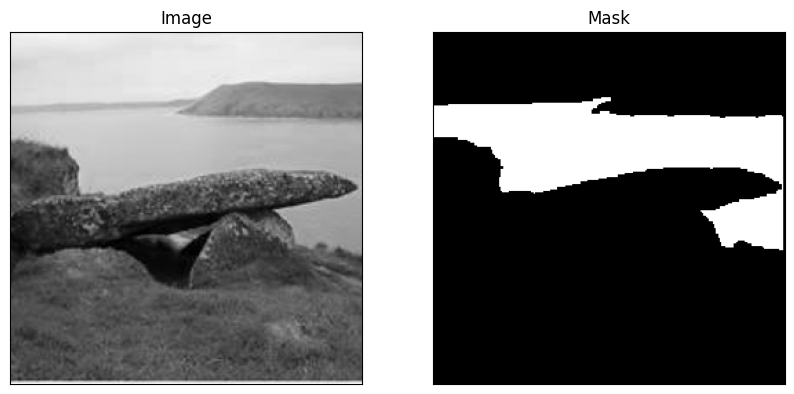

In [ ]:
img_num = random.randint(0, images.shape[0]-1)
example_image = dataset[img_num]["image"]
example_mask = dataset[img_num]["label"]

fig, axes = plt.subplots(1, 2, figsize=(10, 5))

# Plot the first image on the left
axes[0].imshow(np.array(example_image), cmap='gray')  # Assuming the first image is grayscale
axes[0].set_title("Image")

# Plot the second image on the right
axes[1].imshow(example_mask, cmap='gray')  # Assuming the second image is grayscale
axes[1].set_title("Mask")

# Hide axis ticks and labels
for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xticklabels([])
    ax.set_yticklabels([])

# Display the images side by side
plt.show()

In [ ]:
# Initialize the processor
from transformers import SamProcessor
processor = SamProcessor.from_pretrained("facebook/sam-vit-base")

In [ ]:
# Create an instance of the SAMDataset
train_dataset, test_dataset = SAMDataset(dataset=dataset, processor=processor)

NameError: name 'dataset' is not defined

In [ ]:
example = train_dataset[0]
for k,v in example.items():
    print(k,v.shape)

AttributeError: 'list' object has no attribute 'astype'

In [ ]:
# Create a DataLoader instance for the training dataset
from torch.utils.data import DataLoader
train_dataloader = DataLoader(train_dataset, batch_size=4, shuffle=True, drop_last=False)

In [5]:
batch = next(iter(train_dataloader))

for k,v in batch.items():
    print(k,v.shape)

pixel_values torch.Size([20, 3, 1024, 1024])
original_sizes torch.Size([20, 2])
reshaped_input_sizes torch.Size([20, 2])
input_boxes torch.Size([20, 1, 4])
ground_truth_mask torch.Size([20, 256, 256])


In [ ]:
batch["ground_truth_mask"].shape

NameError: name 'batch' is not defined

In [6]:
# Load the model
from transformers import SamModel
model = SamModel.from_pretrained("./MainDir/Untitled Folder/checkpoint_sam_torch",local_files_only=True)

# make sure we only compute gradients for mask decoder
for name, param in model.named_parameters():
    if name.startswith("vision_encoder") or name.startswith("prompt_encoder"):
        param.requires_grad_(False)
     

In [7]:
from torch.optim import Adam
from monai.losses import DiceCELoss

# Initialize the optimizer and the loss function
optimizer = Adam(model.mask_decoder.parameters(), lr=1e-5, weight_decay=0)
seg_loss = DiceCELoss(sigmoid=True, squared_pred=True, reduction='mean')


In [12]:
import gc
gc.collect()
torch.cuda.empty_cache()

In [ ]:
from tqdm import tqdm
from statistics import mean
import torch
from torch.nn.functional import threshold, normalize

#Training loop
num_epochs = 10

device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)

model.train()


for epoch in range(num_epochs):
    epoch_losses = []
    for batch in tqdm(train_dataloader):
      # forward pass
        outputs = model(pixel_values=batch["pixel_values"].to(device),
                      input_boxes=batch["input_boxes"].to(device),
                      multimask_output=False)

      # compute loss
        predicted_masks = outputs.pred_masks.squeeze(1)
        ground_truth_masks = batch["ground_truth_mask"].float().to(device)
        loss = seg_loss(predicted_masks, ground_truth_masks.unsqueeze(1))

      # backward pass (compute gradients of parameters w.r.t. loss)
        optimizer.zero_grad()
        loss.backward()

      # optimize
        optimizer.step()
        epoch_losses.append(loss.item())

    print(f'EPOCH: {epoch}')
    print(f'Mean loss: {mean(epoch_losses)}')

  0%|          | 0/151 [00:01<?, ?it/s]


OutOfMemoryError: CUDA out of memory. Tried to allocate 15.00 GiB. GPU 0 has a total capacty of 31.74 GiB of which 12.99 GiB is free. Process 1550117 has 18.75 GiB memory in use. Of the allocated memory 18.02 GiB is allocated by PyTorch, and 368.29 MiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF

In [ ]:
from tqdm import tqdm
from statistics import mean
import torch
from torch.nn.functional import threshold, normalize
from torch.nn import DataParallel

# Assuming 'model' is your model instance and 'train_dataloader' is your DataLoader instance
# Training loop
num_epochs = 20

# Check if more than one GPU is available
if torch.cuda.device_count() > 1:
    print(f"Let's use {torch.cuda.device_count()} GPUs!")
    # Wrap the model with DataParallel
    model = DataParallel(model)

# Ensure the model is sent to the default device
device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)

model.train()

for epoch in range(num_epochs):
    epoch_losses = []
    for batch in tqdm(train_dataloader):
        # forward pass
        outputs = model(pixel_values=batch["pixel_values"].to(device),
                        input_boxes=batch["input_boxes"].to(device),
                        multimask_output=False)

        # compute loss
        predicted_masks = outputs.pred_masks.squeeze(1)
        ground_truth_masks = batch["ground_truth_mask"].float().to(device)
        loss = seg_loss(predicted_masks, ground_truth_masks.unsqueeze(1))

        # backward pass (compute gradients of parameters w.r.t. loss)
        optimizer.zero_grad()
        loss.backward()

        # optimize
        optimizer.step()
        epoch_losses.append(loss.item())

    print(f'EPOCH: {epoch}')
    print(f'Mean loss: {mean(epoch_losses)}')


Let's use 2 GPUs!


100%|██████████| 151/151 [06:00<00:00,  2.39s/it]


EPOCH: 0
Mean loss: 0.1688113481497133


100%|██████████| 151/151 [05:55<00:00,  2.35s/it]


EPOCH: 1
Mean loss: 0.16649698234157057


100%|██████████| 151/151 [05:57<00:00,  2.37s/it]


EPOCH: 2
Mean loss: 0.16329255285642005


100%|██████████| 151/151 [05:54<00:00,  2.35s/it]


EPOCH: 3
Mean loss: 0.16078551912939312


100%|██████████| 151/151 [05:53<00:00,  2.34s/it]


EPOCH: 4
Mean loss: 0.15568714465526556


100%|██████████| 151/151 [05:52<00:00,  2.34s/it]


EPOCH: 5
Mean loss: 0.1535731457815265


100%|██████████| 151/151 [05:53<00:00,  2.34s/it]


EPOCH: 6
Mean loss: 0.15246358104296867


100%|██████████| 151/151 [05:53<00:00,  2.34s/it]


EPOCH: 7
Mean loss: 0.15075534710426206


100%|██████████| 151/151 [05:52<00:00,  2.33s/it]


EPOCH: 8
Mean loss: 0.14890886330051928


100%|██████████| 151/151 [05:51<00:00,  2.33s/it]


EPOCH: 9
Mean loss: 0.14707653806699034


100%|██████████| 151/151 [05:50<00:00,  2.32s/it]


EPOCH: 10
Mean loss: 0.1436448489494671


100%|██████████| 151/151 [05:52<00:00,  2.34s/it]


EPOCH: 11
Mean loss: 0.14537573566302558


100%|██████████| 151/151 [05:54<00:00,  2.35s/it]


EPOCH: 12
Mean loss: 0.15311021081461812


100%|██████████| 151/151 [06:02<00:00,  2.40s/it]


EPOCH: 13
Mean loss: 0.14442957503511417


100%|██████████| 151/151 [05:54<00:00,  2.35s/it]


EPOCH: 14
Mean loss: 0.144386095815147


100%|██████████| 151/151 [06:05<00:00,  2.42s/it]


EPOCH: 15
Mean loss: 0.13887663353357885


100%|██████████| 151/151 [06:02<00:00,  2.40s/it]


EPOCH: 16
Mean loss: 0.14059779714077514


100%|██████████| 151/151 [06:00<00:00,  2.39s/it]


EPOCH: 17
Mean loss: 0.1379043756435249


100%|██████████| 151/151 [05:57<00:00,  2.37s/it]


EPOCH: 18
Mean loss: 0.13591512489989893


100%|██████████| 151/151 [05:56<00:00,  2.36s/it]

EPOCH: 19
Mean loss: 0.13496454163695012


In [8]:
import matplotlib.pyplot as plt
import numpy as np
import random

# Function to visualize images and masks
def visualize_prediction(image, ground_truth, prediction, epoch):
    fig, axs = plt.subplots(1, 3, figsize=(20, 10))
    axs[0].imshow(image)
    axs[0].set_title('Input Image')
    axs[1].imshow(ground_truth, cmap='gray')
    axs[1].set_title('Ground Truth Mask')
    axs[2].imshow(prediction, cmap='gray')
    axs[2].set_title(f'Predicted Mask - Epoch {epoch+1}')
    for ax in axs:
        ax.axis('off')
    plt.show()


Let's use 2 GPUs!


Epoch 1/30 - Training: 100%|██████████| 151/151 [06:02<00:00,  2.40s/it]


EPOCH: 1, Training Mean Loss: 0.09262801238045787


Epoch 1/30 - Validation: 100%|██████████| 38/38 [01:27<00:00,  2.30s/it]


EPOCH: 1, Validation Mean Loss: 0.13082302832289747


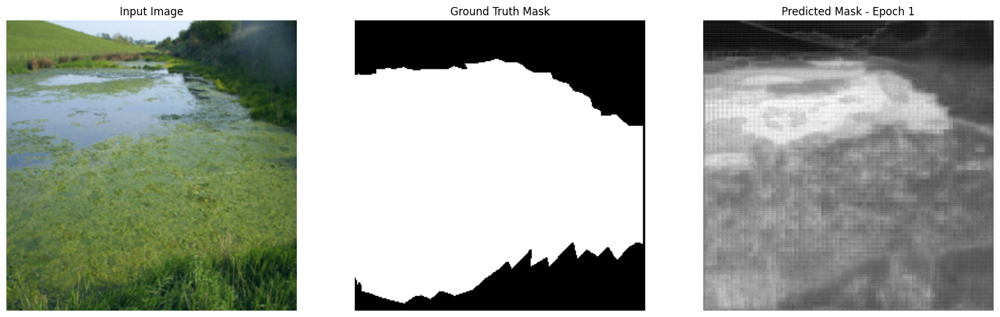

Epoch 2/30 - Training: 100%|██████████| 151/151 [05:57<00:00,  2.37s/it]


EPOCH: 2, Training Mean Loss: 0.09265332755367488


Epoch 2/30 - Validation: 100%|██████████| 38/38 [01:27<00:00,  2.30s/it]


EPOCH: 2, Validation Mean Loss: 0.12844313387023776


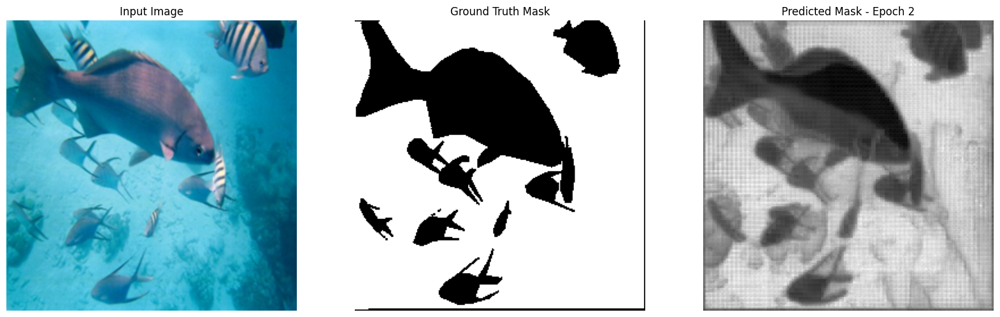

Epoch 3/30 - Training: 100%|██████████| 151/151 [05:58<00:00,  2.38s/it]


EPOCH: 3, Training Mean Loss: 0.09115758015225266


Epoch 3/30 - Validation: 100%|██████████| 38/38 [01:28<00:00,  2.32s/it]


EPOCH: 3, Validation Mean Loss: 0.1339014768600464


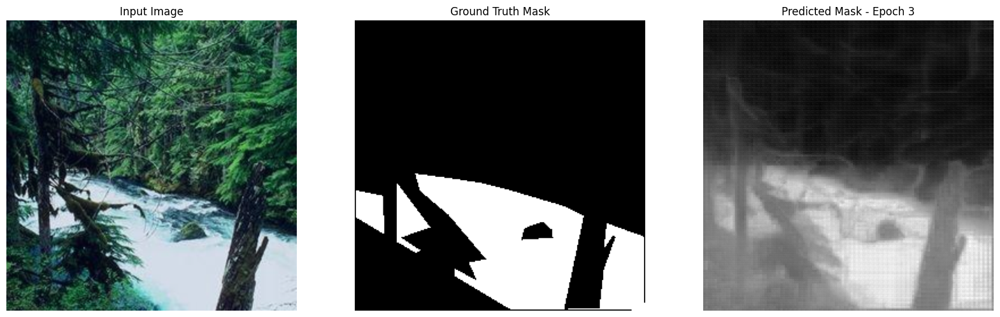

Epoch 4/30 - Training: 100%|██████████| 151/151 [05:56<00:00,  2.36s/it]


EPOCH: 4, Training Mean Loss: 0.09065987747039227


Epoch 4/30 - Validation: 100%|██████████| 38/38 [01:27<00:00,  2.29s/it]


EPOCH: 4, Validation Mean Loss: 0.12833363209900103


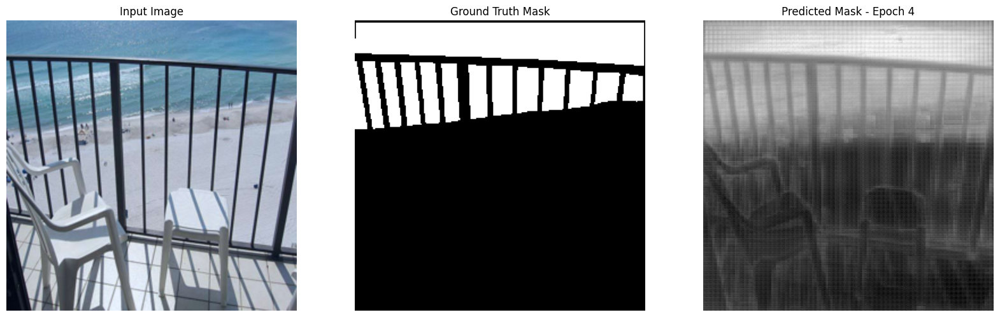

Epoch 5/30 - Training: 100%|██████████| 151/151 [06:05<00:00,  2.42s/it]


EPOCH: 5, Training Mean Loss: 0.09095660436725775


Epoch 5/30 - Validation: 100%|██████████| 38/38 [01:28<00:00,  2.32s/it]


EPOCH: 5, Validation Mean Loss: 0.12853785682665675


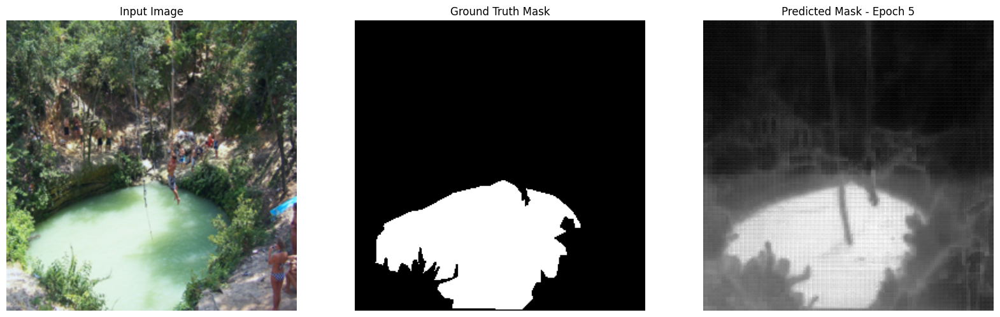

Epoch 6/30 - Training: 100%|██████████| 151/151 [06:00<00:00,  2.39s/it]


EPOCH: 6, Training Mean Loss: 0.0893223314046465


Epoch 6/30 - Validation: 100%|██████████| 38/38 [01:28<00:00,  2.32s/it]


EPOCH: 6, Validation Mean Loss: 0.1274292637643061


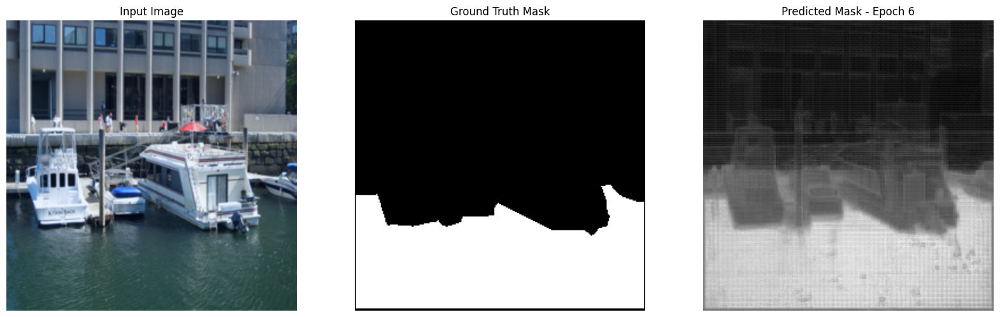

Epoch 7/30 - Training: 100%|██████████| 151/151 [05:59<00:00,  2.38s/it]


EPOCH: 7, Training Mean Loss: 0.0901559041134569


Epoch 7/30 - Validation: 100%|██████████| 38/38 [01:28<00:00,  2.32s/it]


EPOCH: 7, Validation Mean Loss: 0.13144337091791003


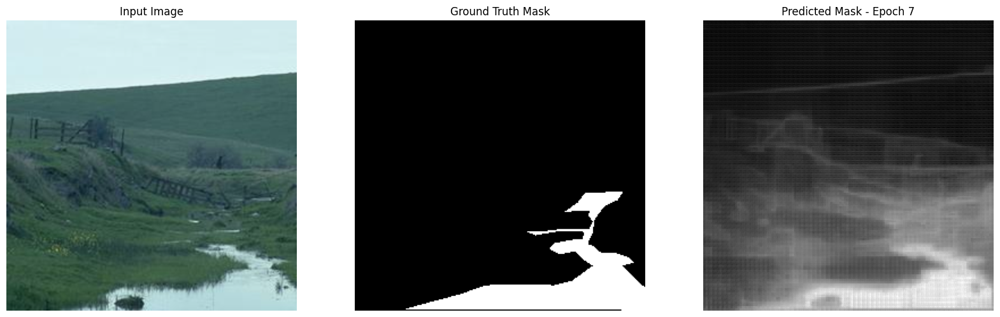

Epoch 8/30 - Training: 100%|██████████| 151/151 [05:58<00:00,  2.38s/it]


EPOCH: 8, Training Mean Loss: 0.08957355173415696


Epoch 8/30 - Validation: 100%|██████████| 38/38 [01:31<00:00,  2.41s/it]


EPOCH: 8, Validation Mean Loss: 0.12622681946346634


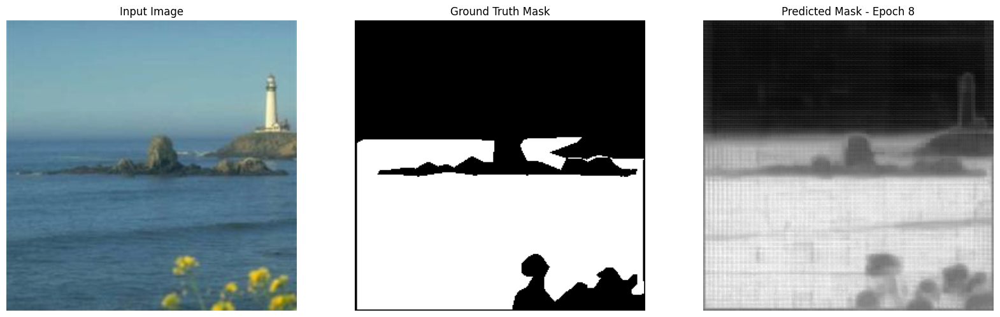

Epoch 9/30 - Training: 100%|██████████| 151/151 [06:01<00:00,  2.39s/it]


EPOCH: 9, Training Mean Loss: 0.09087119414316898


Epoch 9/30 - Validation: 100%|██████████| 38/38 [01:27<00:00,  2.31s/it]


EPOCH: 9, Validation Mean Loss: 0.13211786668551595


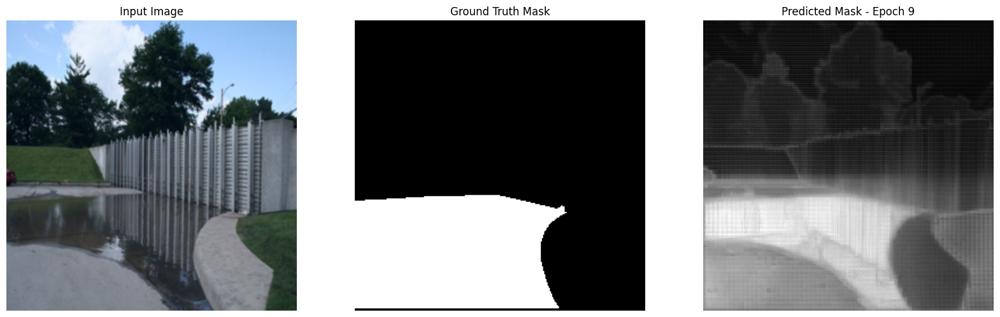

Epoch 10/30 - Training: 100%|██████████| 151/151 [05:58<00:00,  2.38s/it]


EPOCH: 10, Training Mean Loss: 0.08932587731358231


Epoch 10/30 - Validation: 100%|██████████| 38/38 [01:27<00:00,  2.31s/it]


EPOCH: 10, Validation Mean Loss: 0.12777598613971158


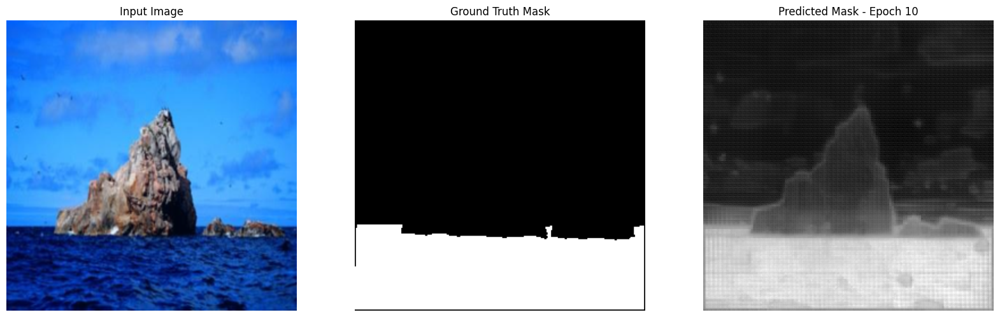

Epoch 11/30 - Training: 100%|██████████| 151/151 [05:59<00:00,  2.38s/it]


EPOCH: 11, Training Mean Loss: 0.08788531364885387


Epoch 11/30 - Validation: 100%|██████████| 38/38 [01:28<00:00,  2.32s/it]


EPOCH: 11, Validation Mean Loss: 0.13202926732207598


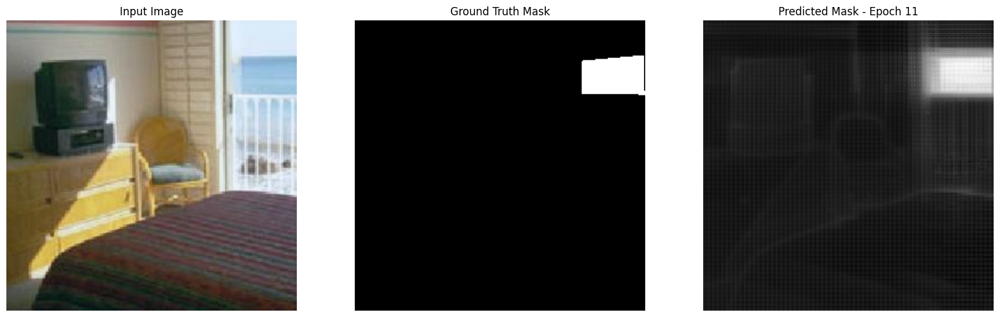

Epoch 12/30 - Training: 100%|██████████| 151/151 [06:01<00:00,  2.39s/it]


EPOCH: 12, Training Mean Loss: 0.0903307774061004


Epoch 12/30 - Validation: 100%|██████████| 38/38 [01:30<00:00,  2.38s/it]


EPOCH: 12, Validation Mean Loss: 0.1302527944116216


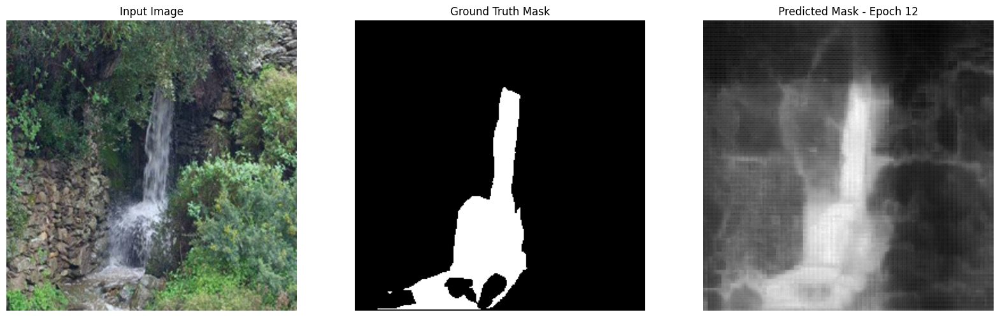

Epoch 13/30 - Training: 100%|██████████| 151/151 [06:07<00:00,  2.43s/it]


EPOCH: 13, Training Mean Loss: 0.08934774590249094


Epoch 13/30 - Validation: 100%|██████████| 38/38 [01:30<00:00,  2.39s/it]


EPOCH: 13, Validation Mean Loss: 0.13200057454799352


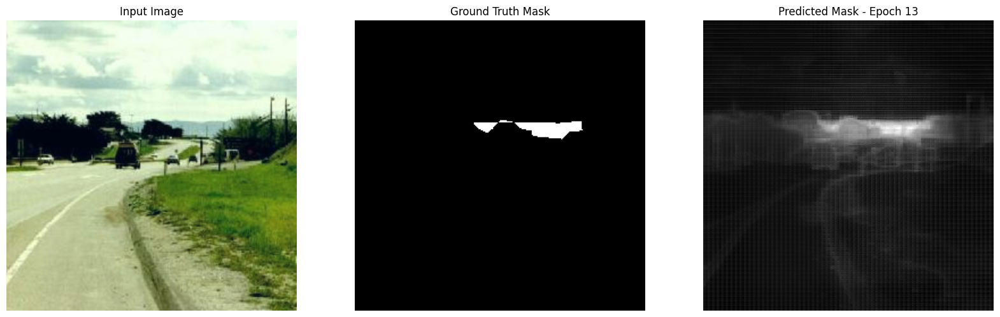

Epoch 14/30 - Training: 100%|██████████| 151/151 [05:59<00:00,  2.38s/it]


EPOCH: 14, Training Mean Loss: 0.09175005140683509


Epoch 14/30 - Validation: 100%|██████████| 38/38 [01:30<00:00,  2.37s/it]


EPOCH: 14, Validation Mean Loss: 0.1312703035379711


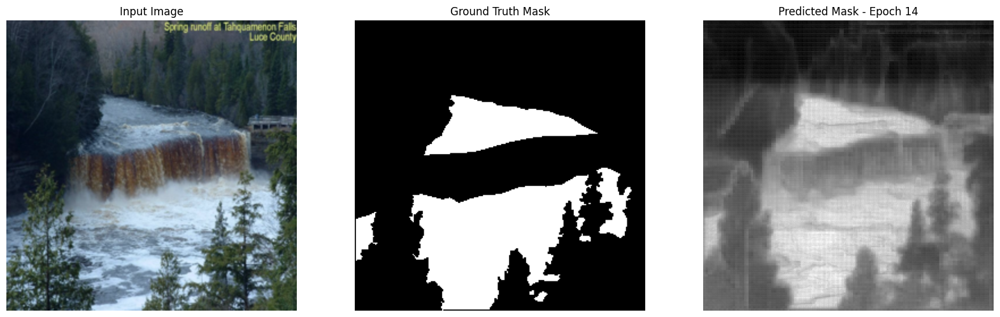

Epoch 15/30 - Training: 100%|██████████| 151/151 [06:04<00:00,  2.41s/it]


EPOCH: 15, Training Mean Loss: 0.08814986812456554


Epoch 15/30 - Validation: 100%|██████████| 38/38 [01:27<00:00,  2.31s/it]


EPOCH: 15, Validation Mean Loss: 0.1306060068309307


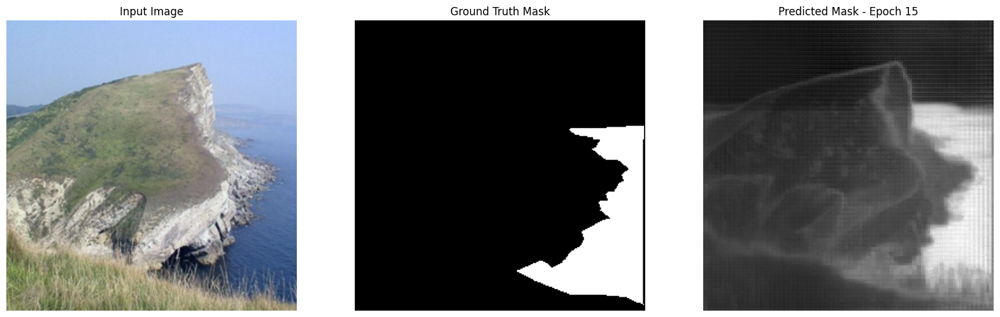

Epoch 16/30 - Training: 100%|██████████| 151/151 [06:11<00:00,  2.46s/it]


EPOCH: 16, Training Mean Loss: 0.08685578243029828


Epoch 16/30 - Validation: 100%|██████████| 38/38 [01:30<00:00,  2.38s/it]


EPOCH: 16, Validation Mean Loss: 0.12660091291916997


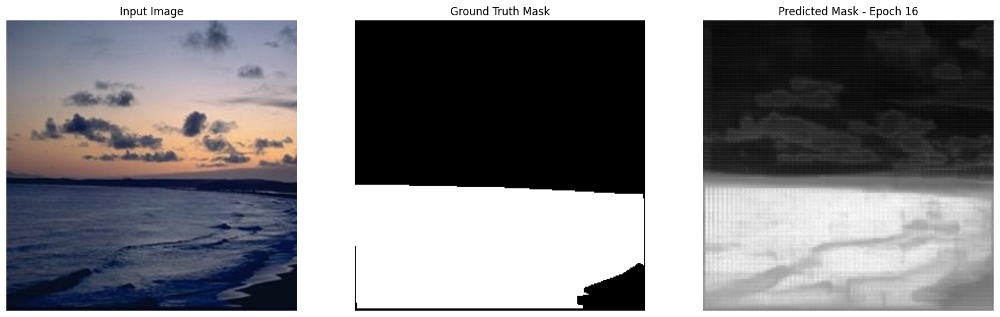

Epoch 17/30 - Training: 100%|██████████| 151/151 [05:58<00:00,  2.38s/it]


EPOCH: 17, Training Mean Loss: 0.08631156907965805


Epoch 17/30 - Validation: 100%|██████████| 38/38 [01:29<00:00,  2.35s/it]


EPOCH: 17, Validation Mean Loss: 0.12681532239443377


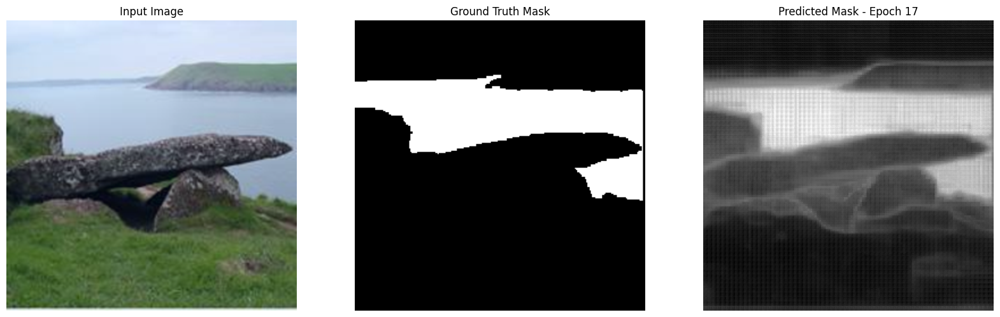

Epoch 18/30 - Training: 100%|██████████| 151/151 [06:05<00:00,  2.42s/it]


EPOCH: 18, Training Mean Loss: 0.08519524856415016


Epoch 18/30 - Validation: 100%|██████████| 38/38 [01:32<00:00,  2.43s/it]


EPOCH: 18, Validation Mean Loss: 0.12650623015667262


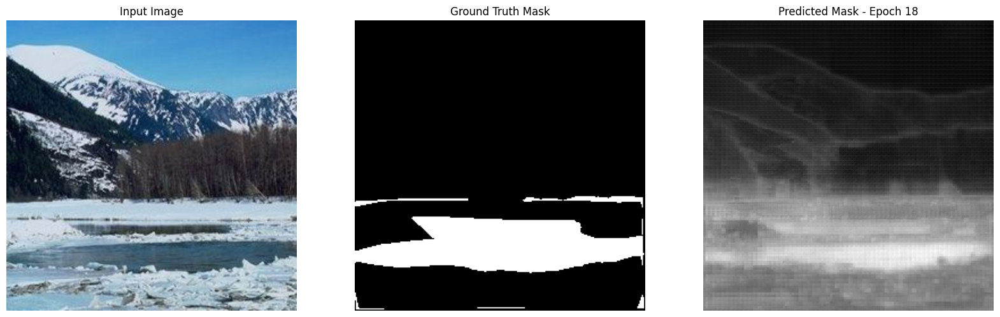

Epoch 19/30 - Training: 100%|██████████| 151/151 [06:09<00:00,  2.45s/it]


EPOCH: 19, Training Mean Loss: 0.08567930528561012


Epoch 19/30 - Validation: 100%|██████████| 38/38 [01:27<00:00,  2.32s/it]


EPOCH: 19, Validation Mean Loss: 0.12257268985635356


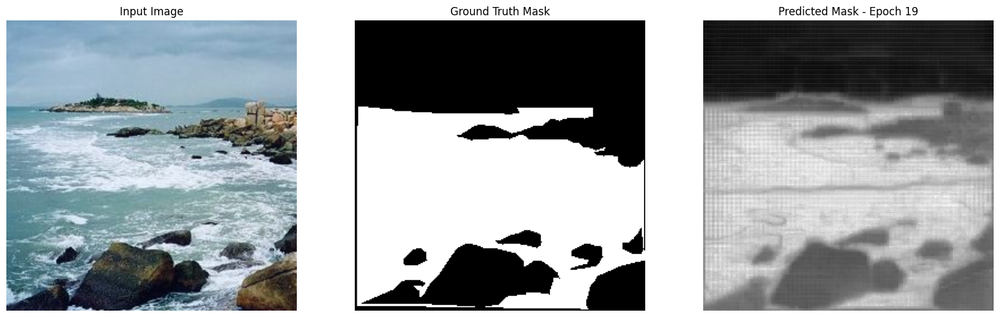

Epoch 20/30 - Training: 100%|██████████| 151/151 [05:58<00:00,  2.38s/it]


EPOCH: 20, Training Mean Loss: 0.08503935384927996


Epoch 20/30 - Validation: 100%|██████████| 38/38 [01:28<00:00,  2.32s/it]


EPOCH: 20, Validation Mean Loss: 0.1249401792883873


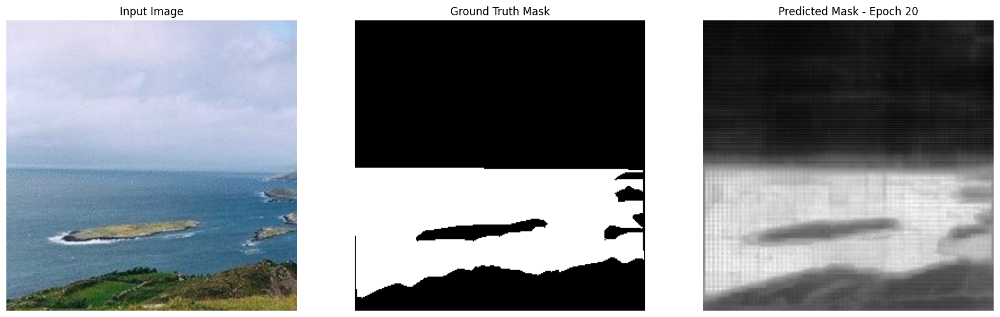

Epoch 21/30 - Training: 100%|██████████| 151/151 [05:59<00:00,  2.38s/it]


EPOCH: 21, Training Mean Loss: 0.08537398934956418


Epoch 21/30 - Validation: 100%|██████████| 38/38 [01:31<00:00,  2.40s/it]


EPOCH: 21, Validation Mean Loss: 0.1288560736728342


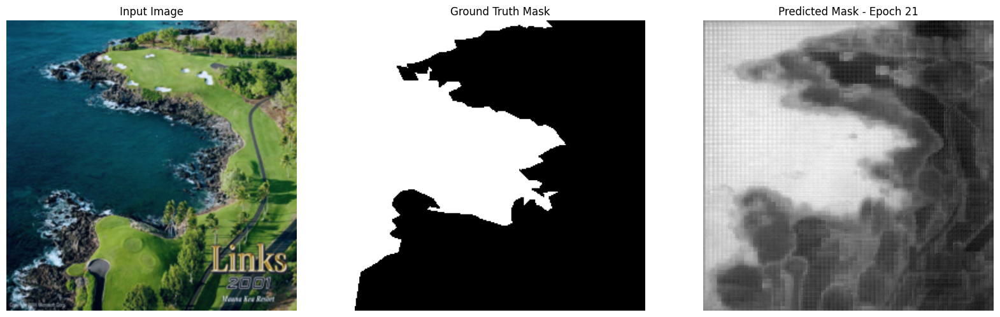

Epoch 22/30 - Training: 100%|██████████| 151/151 [06:04<00:00,  2.42s/it]


EPOCH: 22, Training Mean Loss: 0.0845547037211475


Epoch 22/30 - Validation: 100%|██████████| 38/38 [01:29<00:00,  2.35s/it]


EPOCH: 22, Validation Mean Loss: 0.1293244355995404


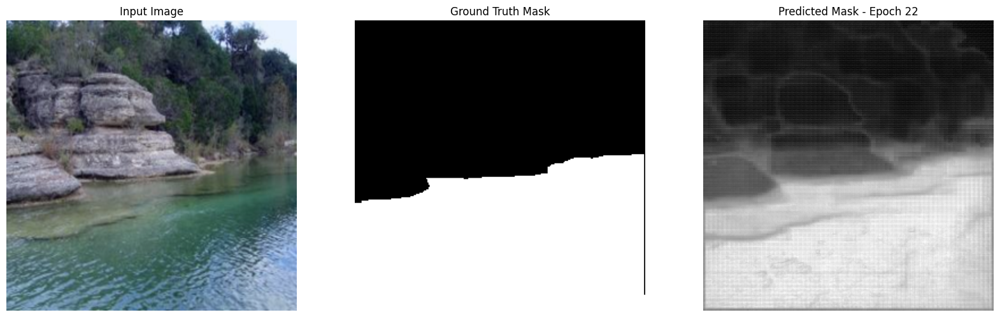

Epoch 23/30 - Training: 100%|██████████| 151/151 [06:08<00:00,  2.44s/it]


EPOCH: 23, Training Mean Loss: 0.08486761670831024


Epoch 23/30 - Validation: 100%|██████████| 38/38 [01:28<00:00,  2.32s/it]


EPOCH: 23, Validation Mean Loss: 0.12739281317121104


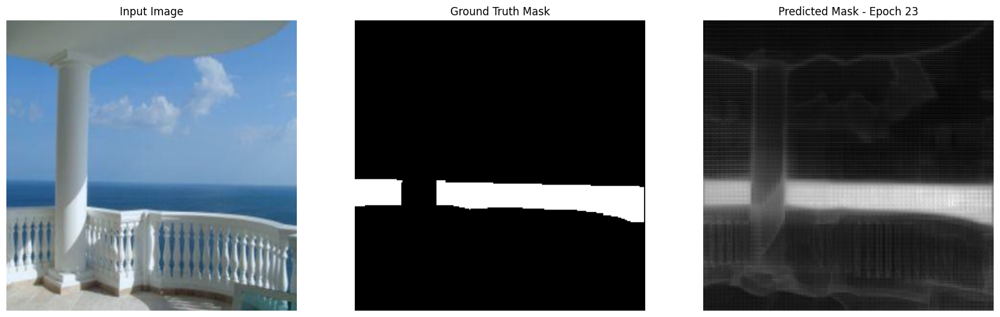

Epoch 24/30 - Training: 100%|██████████| 151/151 [06:02<00:00,  2.40s/it]


EPOCH: 24, Training Mean Loss: 0.08345024544276938


Epoch 24/30 - Validation: 100%|██████████| 38/38 [01:28<00:00,  2.32s/it]


EPOCH: 24, Validation Mean Loss: 0.12417755981809214


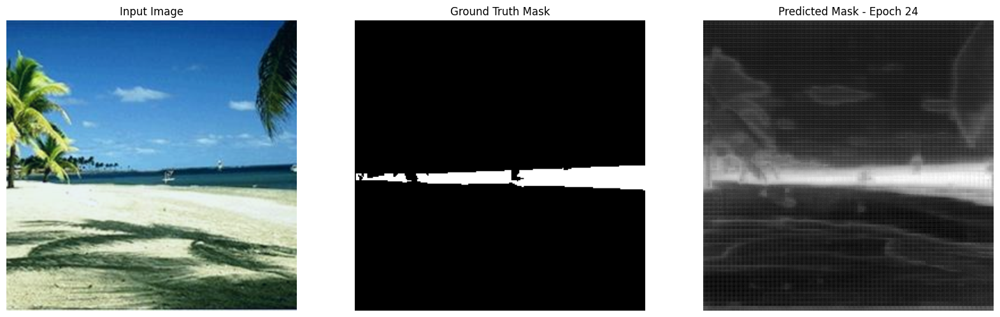

Epoch 25/30 - Training: 100%|██████████| 151/151 [06:03<00:00,  2.41s/it]


EPOCH: 25, Training Mean Loss: 0.08374142459291496


Epoch 25/30 - Validation: 100%|██████████| 38/38 [01:29<00:00,  2.34s/it]


EPOCH: 25, Validation Mean Loss: 0.12197645361486234


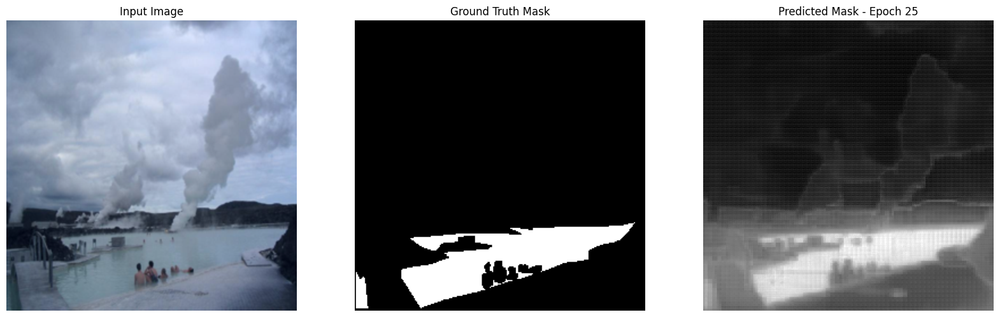

Epoch 26/30 - Training: 100%|██████████| 151/151 [06:00<00:00,  2.39s/it]


EPOCH: 26, Training Mean Loss: 0.08339445142457817


Epoch 26/30 - Validation: 100%|██████████| 38/38 [01:27<00:00,  2.31s/it]


EPOCH: 26, Validation Mean Loss: 0.1307843952978912


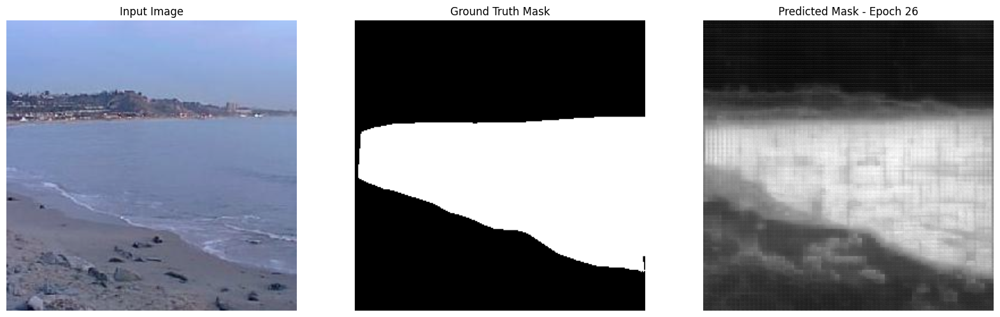

Epoch 27/30 - Training: 100%|██████████| 151/151 [05:59<00:00,  2.38s/it]


EPOCH: 27, Training Mean Loss: 0.08483074857107062


Epoch 27/30 - Validation: 100%|██████████| 38/38 [01:28<00:00,  2.33s/it]


EPOCH: 27, Validation Mean Loss: 0.12344265591941382


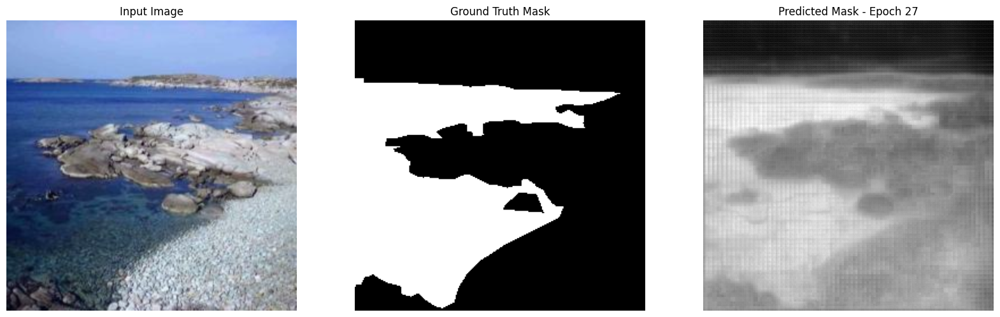

Epoch 28/30 - Training: 100%|██████████| 151/151 [06:02<00:00,  2.40s/it]


EPOCH: 28, Training Mean Loss: 0.0850639185615328


Epoch 28/30 - Validation: 100%|██████████| 38/38 [01:27<00:00,  2.31s/it]


EPOCH: 28, Validation Mean Loss: 0.12743124934403519


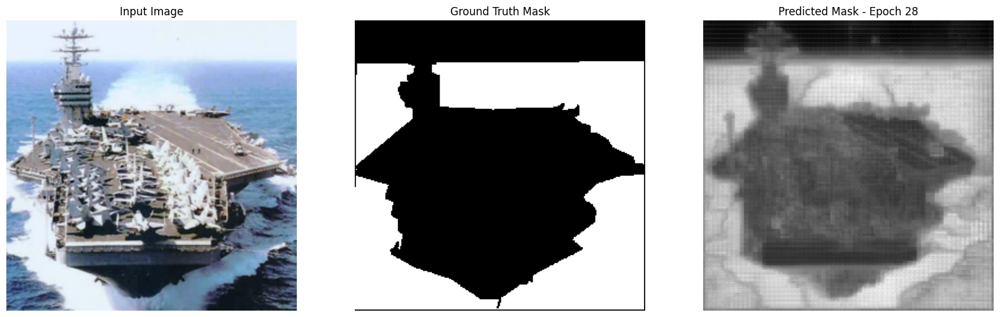

Epoch 29/30 - Training: 100%|██████████| 151/151 [06:00<00:00,  2.39s/it]


EPOCH: 29, Training Mean Loss: 0.0853671541819904


Epoch 29/30 - Validation: 100%|██████████| 38/38 [01:27<00:00,  2.31s/it]


EPOCH: 29, Validation Mean Loss: 0.12365632151302539


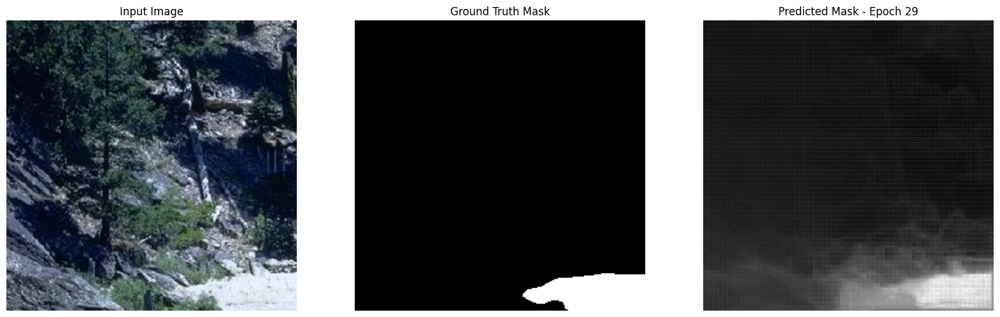

Epoch 30/30 - Training: 100%|██████████| 151/151 [06:03<00:00,  2.41s/it]


EPOCH: 30, Training Mean Loss: 0.08353287050660872


Epoch 30/30 - Validation: 100%|██████████| 38/38 [01:28<00:00,  2.32s/it]


EPOCH: 30, Validation Mean Loss: 0.1306462662392541


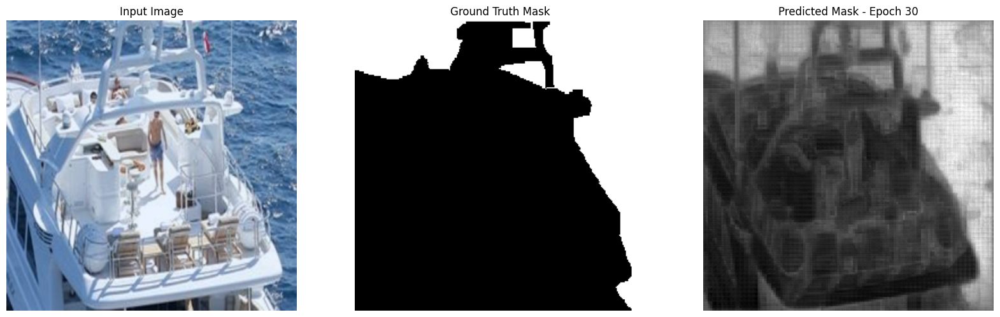

In [9]:
from tqdm import tqdm
from statistics import mean
import torch
from torch.nn import DataParallel

# Assuming 'model', 'train_dataloader', and 'test_dataloader' are defined
# Also assuming 'optimizer' and 'seg_loss' are defined elsewhere

num_epochs = 30

# Check if more than one GPU is available and wrap the model with DataParallel
if torch.cuda.device_count() > 1:
    print(f"Let's use {torch.cuda.device_count()} GPUs!")
    model = DataParallel(model)

# Ensure the model is sent to the default device
device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)

for epoch in range(num_epochs):
    model.train()  # Set model to training mode
    epoch_losses = []

    # Training loop
    for batch in tqdm(train_dataloader, desc=f"Epoch {epoch + 1}/{num_epochs} - Training"):
        pixel_values = batch["pixel_values"].to(device)
        input_boxes = batch["input_boxes"].to(device)
        ground_truth_masks = batch["ground_truth_mask"].float().to(device)

        outputs = model(pixel_values=pixel_values, input_boxes=input_boxes, multimask_output=False)
        predicted_masks = outputs.pred_masks.squeeze(1)
        loss = seg_loss(predicted_masks, ground_truth_masks.unsqueeze(1))

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        epoch_losses.append(loss.item())

    print(f'EPOCH: {epoch + 1}, Training Mean Loss: {mean(epoch_losses)}')

    # Validation loop
    model.eval()  # Set model to evaluation mode
    val_losses = []

    with torch.no_grad():
        for batch in tqdm(test_dataloader, desc=f"Epoch {epoch + 1}/{num_epochs} - Validation"):
            pixel_values = batch["pixel_values"].to(device)
            input_boxes = batch["input_boxes"].to(device)
            ground_truth_masks = batch["ground_truth_mask"].float().to(device)

            outputs = model(pixel_values=pixel_values, input_boxes=input_boxes, multimask_output=False)
            predicted_masks = outputs.pred_masks.squeeze(1)
            loss = seg_loss(predicted_masks, ground_truth_masks.unsqueeze(1))

            val_losses.append(loss.item())

    print(f'EPOCH: {epoch + 1}, Validation Mean Loss: {mean(val_losses)}')
    model.eval()
    with torch.no_grad():

        val_iter = iter(test_dataloader)
        batch = next(val_iter)
        
        pixel_values = batch["pixel_values"].to(device)
        input_boxes = batch["input_boxes"].to(device)
        ground_truth_masks = batch["ground_truth_mask"].float().to(device)
        
        outputs = model(pixel_values=pixel_values, input_boxes=input_boxes, multimask_output=False)
        predicted_masks = outputs.pred_masks.squeeze(1)
        
        idx = random.randint(0, pixel_values.size(0) - 1)
        image_to_show = pixel_values[idx].cpu().detach().numpy().transpose(1, 2, 0)
        ground_truth_to_show = ground_truth_masks[idx].cpu().detach().numpy()
        predicted_mask_to_show = predicted_masks[idx].cpu().detach().numpy()
        image_to_show = image_to_show.squeeze()  # This is probably already OK if it's RGB
        ground_truth_to_show = ground_truth_to_show.squeeze()
        predicted_mask_to_show = predicted_mask_to_show.squeeze()
        
        image_to_show = (image_to_show - image_to_show.min()) / (image_to_show.max() - image_to_show.min())
        
        visualize_prediction(image_to_show, ground_truth_to_show, predicted_mask_to_show, epoch)

In [1]:
original_model = model.module

original_model.save_pretrained('./MainDir/Untitled Folder/checkpoint_sam_torch')

NameError: name 'model' is not defined

In [45]:
torch.save(original_model.state_dict(), "./MainDir/Untitled Folder/checkpoint_sam_torch/model_checkpoint1302_2.pth")

In [11]:
original_model.config.save_pretrained('./MainDir/Untitled Folder/checkpoint_sam_torch')

In [2]:
from transformers import AutoModel

model_path = "./MainDir/Untitled Folder/checkpoint_sam_torch"  # Adjust path as needed
model = AutoModel.from_pretrained(model_path)

In [3]:
from transformers import SamModel, SamConfig, SamProcessor

# Load the model configuration
model_config = SamConfig.from_pretrained("D:\zerovision\checkpoint",local_files_only=True)
processor = SamProcessor.from_pretrained("D:\zerovision\checkpoint",local_files_only=True)
model = SamModel.from_pretrained("D:\zerovision\checkpoint",local_files_only=True)

In [2]:

from transformers import SamModel, SamConfig, SamProcessor
import torch

In [1]:
# Load the model configuration
model_config = SamConfig.from_pretrained("facebook/sam-vit-base")
processor = SamProcessor.from_pretrained("facebook/sam-vit-base")

# Create an instance of the model architecture with the loaded configuration
my_wase_model = SamModel(config=model_config)
#Update the model by loading the weights from saved file.
my_wase_model.load_state_dict(torch.load("./MainDir/Untitled Folder/checkpoint_sam_torch/model_checkpoint1302_2.pth"))


NameError: name 'SamConfig' is not defined

In [4]:

# set the device to cuda if available, otherwise use cpu
# device = "cuda" if torch.cuda.is_available() else "cpu"
device = "cpu"
model.to(device)

SamModel(
  (shared_image_embedding): SamPositionalEmbedding()
  (vision_encoder): SamVisionEncoder(
    (patch_embed): SamPatchEmbeddings(
      (projection): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
    )
    (layers): ModuleList(
      (0-11): 12 x SamVisionLayer(
        (layer_norm1): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (attn): SamVisionAttention(
          (qkv): Linear(in_features=768, out_features=2304, bias=True)
          (proj): Linear(in_features=768, out_features=768, bias=True)
        )
        (layer_norm2): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (mlp): SamMLPBlock(
          (lin1): Linear(in_features=768, out_features=3072, bias=True)
          (lin2): Linear(in_features=3072, out_features=768, bias=True)
          (act): GELUActivation()
        )
      )
    )
    (neck): SamVisionNeck(
      (conv1): Conv2d(768, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (layer_norm1): SamLayerNorm()
     

In [69]:
len(test_dataset)

756

In [75]:
import numpy as np
import random
import torch
import matplotlib.pyplot as plt

# let's take a random training example
idx = random.randint(0,150)

# load image
test_image = test_dataloader[idx][images]

# get box prompt based on ground truth segmentation map
ground_truth_mask = np.array(test_data[idx]["label"])
prompt = get_bounding_box(ground_truth_mask)

# prepare image + box prompt for the model
inputs = processor(test_image, input_boxes=[[prompt]], return_tensors="pt")

# Move the input tensor to the GPU if it's not already there
inputs = {k: v.to(device) for k, v in inputs.items()}

model.eval()

# forward pass
with torch.no_grad():
    outputs = model(**inputs, multimask_output=False)

# apply sigmoid
medsam_seg_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
# convert soft mask to hard mask
medsam_seg_prob = medsam_seg_prob.cpu().numpy().squeeze()
medsam_seg = (medsam_seg_prob > 0.5).astype(np.uint8)


fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the first image on the left
axes[0].imshow(np.array(test_image), cmap='gray')  # Assuming the first image is grayscale
axes[0].set_title("Image")

# Plot the second image on the right
axes[1].imshow(medsam_seg, cmap='gray')  # Assuming the second image is grayscale
axes[1].set_title("Mask")

# Plot the second image on the right
axes[2].imshow(medsam_seg_prob)  # Assuming the second image is grayscale
axes[2].set_title("Probability Map")

# Hide axis ticks and labels
for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xticklabels([])
    ax.set_yticklabels([])

# Display the images side by side
plt.show()

TypeError: 'DataLoader' object is not subscriptable

In [ ]:
from PIL import Image

#Apply a trained model on large image
large_test_image = "/kaggle/input/wastewater/WhatsApp Grsel 2023-09-25 saat 17.24.04.jpg"
img = Image.open(large_test_image)
img = img.convert("L")
n_im = np.ndarray(img).astype(np.float32)
print(n_im.shape)
patches = patchify(im, (256, 256), step=256)  #Step=256 for 256 patches means no overlap


TypeError: expected a sequence of integers or a single integer, got '<PIL.Image.Image image mode=L size=768x1024 at 0x7F1A147120B0>'

In [ ]:
# Load a normal image (you need to specify the path to your image)
normal_image_path = "./images/w1.jpg"
test_image = Image.open(normal_image_path)
test_image = test_image
# Get the box prompt based on the image size (you may need to adjust this based on your use case)
prompt = [0, 0, test_image.width, test_image.height]

# # Prepare the image + box prompt for the model
# inputs = processor(test_image, input_boxes=[prompt], return_tensors="pt")
# Modify the prompt to be in the expected format
prompt = [[prompt]]  # Wrap it in an extra list


input_boxes = batch["input_boxes"].to(device)
ground_truth_masks = batch["ground_truth_mask"].float().to(device)

outputs = model(pixel_values=pixel_values, input_boxes=input_boxes, multimask_output=False)
predicted_masks = outputs.pred_masks.squeeze(1)

idx = random.randint(0, pixel_values.size(0) - 1)
image_to_show = pixel_values[idx].cpu().detach().numpy().transpose(1, 2, 0)
ground_truth_to_show = ground_truth_masks[idx].cpu().detach().numpy()
predicted_mask_to_show = predicted_masks[idx].cpu().detach().numpy()
image_to_show = image_to_show.squeeze()  # This is probably already OK if it's RGB
ground_truth_to_show = ground_truth_to_show.squeeze()
predicted_mask_to_show = predicted_mask_to_show.squeeze()

image_to_show = (image_to_show - image_to_show.min()) / (image_to_show.max() - image_to_show.min())

visualize_prediction(image_to_show, ground_truth_to_show, predicted_mask_to_show, epoch)

{'pixel_values': tensor([[[[-0.2342, -0.2171, -0.1999,  ...,  0.0000,  0.0000,  0.0000],
          [-0.2171, -0.2171, -0.1999,  ...,  0.0000,  0.0000,  0.0000],
          [-0.2171, -0.1999, -0.1999,  ...,  0.0000,  0.0000,  0.0000],
          ...,
          [-1.3815, -1.2617, -1.0733,  ...,  0.0000,  0.0000,  0.0000],
          [-1.3644, -1.2788, -1.2274,  ...,  0.0000,  0.0000,  0.0000],
          [-1.3987, -1.3302, -1.3302,  ...,  0.0000,  0.0000,  0.0000]],

         [[ 0.5728,  0.5903,  0.6078,  ...,  0.0000,  0.0000,  0.0000],
          [ 0.5903,  0.5903,  0.6078,  ...,  0.0000,  0.0000,  0.0000],
          [ 0.5903,  0.6078,  0.6078,  ...,  0.0000,  0.0000,  0.0000],
          ...,
          [-1.2129, -1.0728, -0.8803,  ...,  0.0000,  0.0000,  0.0000],
          [-1.1779, -1.0903, -1.0203,  ...,  0.0000,  0.0000,  0.0000],
          [-1.2129, -1.1253, -1.1253,  ...,  0.0000,  0.0000,  0.0000]],

         [[ 1.9254,  1.9428,  1.9603,  ...,  0.0000,  0.0000,  0.0000],
          [ 1

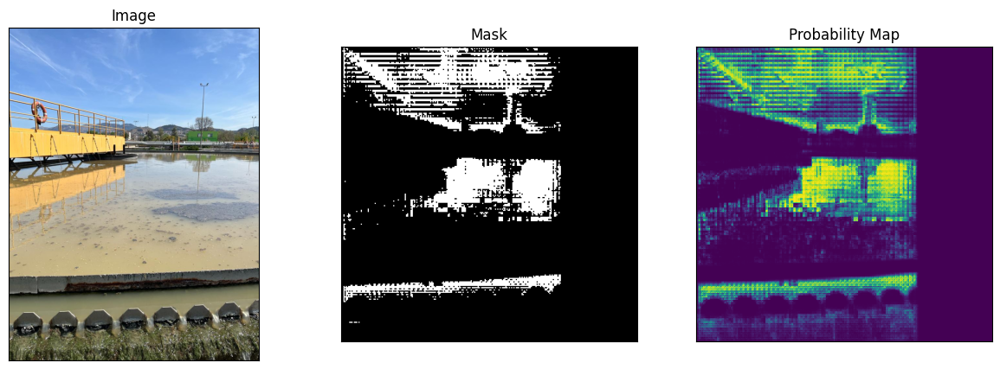

In [12]:
import numpy as np
import random
import torch
import matplotlib.pyplot as plt
from PIL import Image

# Load a normal image (you need to specify the path to your image)
normal_image_path = "../images/w1.jpg"
test_image = Image.open(normal_image_path)
image = test_image.resize((256, 256))
# Get the box prompt based on the image size (you may need to adjust this based on your use case)
# prompt = [0, 0, test_image.width, test_image.height]
ground_truth_mask = np.array(test_image)

prompt = get_bounding_box(ground_truth_mask)

# Process image and bounding box with the processor
inputs = processor(images=test_image, input_boxes=[[prompt]], return_tensors="pt")
inputs = {k: v.cpu() for k, v in inputs.items()}
# inputs["ground_truth_mask"] = ground_truth_mask


# # Prepare the image + box prompt for the model
# inputs = processor(test_image, input_boxes=prompt, return_tensors="pt")

# # Move the input tensor to the GPU if it's not already there
# inputs = {k: v.to(device) for k, v in inputs.items()}

# Set the model to evaluation mode
model.eval()
print(inputs)
# Forward pass
with torch.no_grad():
    outputs = model(**inputs, multimask_output=False)

# Apply sigmoid
medsam_seg_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
# Convert soft mask to hard mask
medsam_seg_prob = medsam_seg_prob.cpu().numpy().squeeze()
medsam_seg = (medsam_seg_prob > 0.5).astype(np.uint8)

# Create a figure for plotting
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the original image on the left
axes[0].imshow(np.array(test_image), cmap='gray')
axes[0].set_title("Image")

# Plot the segmentation mask in the middle
axes[1].imshow(medsam_seg, cmap='gray')
axes[1].set_title("Mask")

# Plot the probability map on the right
axes[2].imshow(medsam_seg_prob, cmap='viridis')  # You can choose a different colormap
axes[2].set_title("Probability Map")

# Hide axis ticks and labels
for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xticklabels([])
    ax.set_yticklabels([])

# Display the images side by side
plt.show()


In [15]:

import numpy as np
import matplotlib.pyplot as plt
import gc

def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30 / 255, 144 / 255, 255 / 255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)
    del mask
    gc.collect()

def show_masks_on_image(raw_image, masks):
  plt.imshow(np.array(raw_image))
  ax = plt.gca()
  ax.set_autoscale_on(False)
  for mask in masks:
      show_mask(mask, ax=ax, random_color=True)
  plt.axis("off")
  plt.show()
  del mask
  gc.collect()

In [18]:
from transformers import pipeline

generator = pipeline("mask-generation", model="D:\zerovision\checkpoint")


In [14]:
import torch
from PIL import Image
import requests
from transformers import SamModel, SamProcessor

device = "cpu"
model.to(device)

img_url = "https://huggingface.co/ybelkada/segment-anything/resolve/main/assets/car.png"
raw_image = Image.open(requests.get(img_url, stream=True).raw).convert("RGB")
input_points = [[[450, 600]]]  # 2D location of a window in the image

inputs = processor(raw_image, input_points=input_points, return_tensors="pt").to(device)
with torch.no_grad():
    outputs = model(**inputs)

masks = processor.image_processor.post_process_masks(
    outputs.pred_masks.cpu(), inputs["original_sizes"].cpu(), inputs["reshaped_input_sizes"].cpu()
)
scores = outputs.iou_scores

In [21]:
import numpy as np
import random
import torch
import matplotlib.pyplot as plt
from PIL import Image

# Load a normal image (you need to specify the path to your image)
normal_image_path = "../images/w1.jpg"
test_image = Image.open(normal_image_path)
image = test_image.resize((256, 256))

outputs = generator(image, points_per_batch=64)

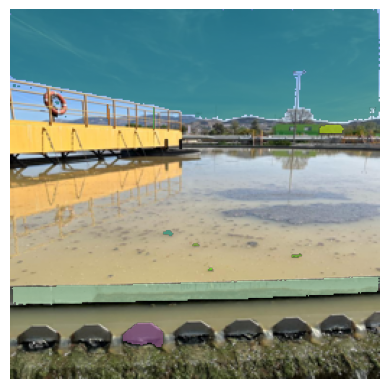

In [22]:
masks = outputs["masks"]
show_masks_on_image(image, masks)

TypeError: Invalid shape (3, 256, 256) for image data

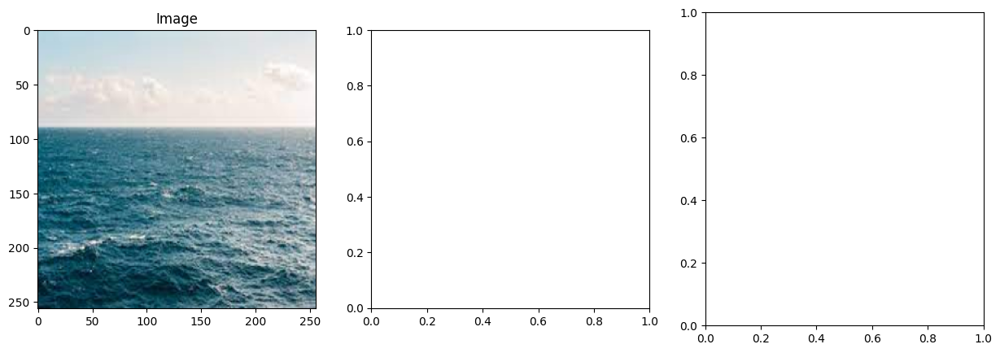

In [14]:
from PIL import Image
import torch
import numpy as np
from torchvision import transforms

# Assuming 'model' is your pre-trained model and 'device' is defined
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Load and preprocess an image
image_path = "./water-segmentation-dataset/water_v1/water_v1/JPEGImages/ADE20K/ADE_train_00000568.png"
image = Image.open(image_path) # Convert to RGB if your model expects 3 channels

# Transpose the image tensor
image = image.transpose(Image.TRANSPOSE)

# Resize the image to the desired shape
image = image.resize((1024, 1024))

# Define transformati

# Apply transformations
input_tensor = transform(image).unsqueeze(0).to(device)  # Add batch dimension and move to device

# Model inference
model.eval()  # Set model to evaluation mode
with torch.no_grad():
    output = model(input_tensor)


# Process the output as needed
    
# Apply sigmoid
medsam_seg_prob = torch.sigmoid(output.pred_masks.squeeze(1))
# Convert soft mask to hard mask
medsam_seg_prob = medsam_seg_prob.cpu().numpy().squeeze()
medsam_seg = (medsam_seg_prob > 0.5).astype(np.uint8)

# Create a figure for plotting
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the original image on the left
axes[0].imshow(np.array(test_image))
axes[0].set_title("Image")

# Plot the segmentation mask in the middle
axes[1].imshow(medsam_seg)
axes[1].set_title("Mask")

# Plot the probability map on the right
axes[2].imshow(medsam_seg_prob, cmap='viridis')  # You can choose a different colormap
axes[2].set_title("Probability Map")

# Hide axis ticks and labels
for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xticklabels([])
    ax.set_yticklabels([])

# Display the images side by side
plt.show()


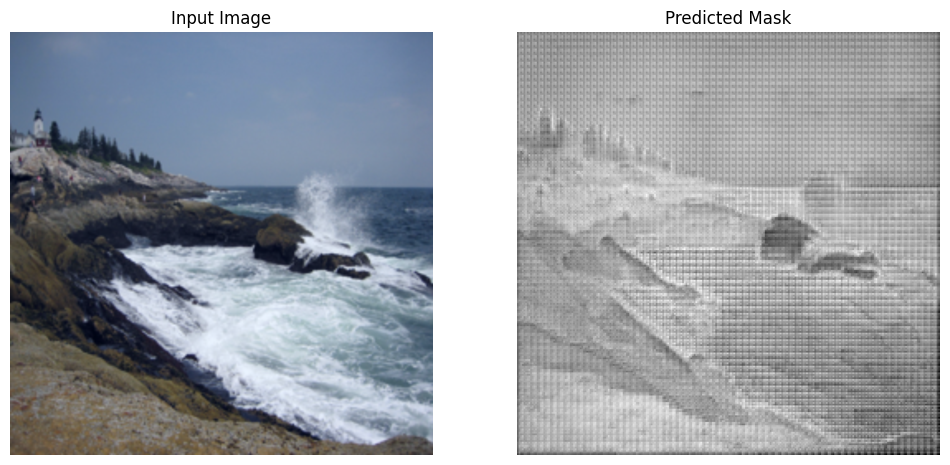

In [8]:
import torch
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from torchvision.transforms import Compose, ToTensor, Normalize, Resize

# Assuming your model and necessary libraries are already imported

# Configure the device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)
model.eval()  # Evaluation mode

# Image preprocessing transforms, adjust as necessary for your model
preprocess = Compose([
    Resize((1024, 1024)),  # Resize to the input size expected by your model
    ToTensor(),  # Convert image to tensor
    Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),  # Normalize (example values)
])

# Function to load and preprocess an image
def prepare_image(image_path):
    image = Image.open(image_path).convert("RGB")  # Ensure image is RGB
    image = image.resize((256, 256))
    image = preprocess(image)
    
    return image.unsqueeze(0)  # Add batch dimension

def visualize_prediction_only(image_np, prediction):
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))
    
    # Visualize the input image
    axs[0].imshow(image_np)
    axs[0].set_title('Input Image')
    
    # Adjust prediction visualization logic based on its shape
    if prediction.ndim == 3 and prediction.shape[0] == 1:
        # If prediction is in the form (1, H, W), squeeze the singleton dimension
        prediction = prediction.squeeze(0)
    elif prediction.ndim == 3:
        # If prediction is in some other 3-dimensional shape, such as (C, H, W) with C > 1,
        # you might need to select a specific channel or aggregate channels in some way.
        # For simplicity, let's assume we're interested in the first channel.
        # Adjust as needed for your specific use case.
        prediction = prediction[0]
    elif prediction.ndim != 2:
        # If prediction does not match expected 2D (H, W) shape, raise an error
        raise ValueError(f"Unexpected prediction shape {prediction.shape}, check model output")

    axs[1].imshow(prediction, cmap='gray')
    axs[1].set_title('Predicted Mask')
    for ax in axs:
        ax.axis('off')
    plt.show()




# Example usage
image_path = "water-segmentation-dataset/water_v1/water_v1/JPEGImages/ADE20K/ADE_train_00000568.png"  # Specify the path to your image
image_tensor = prepare_image(image_path).to(device)

with torch.no_grad():
    # Predict mask
    output = model(image_tensor)  # Adjust this call according to your model's requirements
    predicted_mask = output['pred_masks'].squeeze().cpu().numpy()  # Adjust based on your model output

    # Convert input image tensor to numpy for visualization
    input_image_np = image_tensor.squeeze().cpu().numpy().transpose(1, 2, 0)
    input_image_np = (input_image_np - input_image_np.min()) / (input_image_np.max() - input_image_np.min())  # Normalize

    # Visualize
    visualize_prediction_only(input_image_np, predicted_mask)


In [35]:
print(predicted_mask.shape)  # Add this line before the visualize_prediction_only call


(3, 256, 256)


In [5]:
import numpy as np
import torch
from PIL import Image
import matplotlib.pyplot as plt

# Assuming device configuration is already set up earlier in your code
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Load an image
normal_image_path = "./images/sea.jpeg"
test_image = Image.open(normal_image_path).convert('RGB')  # Convert to RGB to ensure compatibility
test_image = test_image.resize((256, 256))
# Create a prompt based on the image size
prompt = [0, 0, test_image.width, test_image.height]
prompt = [[prompt]]  # Modify the prompt to be in the expected format for the processor

# Assuming 'processor' prepares the image and bounding box for the model
inputs = processor(test_image, input_boxes=prompt, return_tensors="pt")

# Move the input tensor to the GPU if available
inputs = {k: v.to(device) for k, v in inputs.items()}

# Set the model to evaluation mode
model.eval()

# Forward pass without gradient calculation
with torch.no_grad():
    outputs = model(**inputs, multimask_output=False)

# Apply sigmoid to the predicted mask to obtain probabilities
medsam_seg_prob = torch.sigmoid(outputs['pred_masks'].squeeze(1))  # Ensure this matches your model output structure
# Convert the soft mask to a hard mask
medsam_seg_prob = medsam_seg_prob.cpu().numpy().squeeze()
medsam_seg = (medsam_seg_prob > 0.80).astype(np.uint8)

# Create a figure for plotting
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the original image
axes[0].imshow(np.array(test_image))
axes[0].set_title("Image")

# Plot the segmentation mask
axes[1].imshow(medsam_seg, cmap='gray')
axes[1].set_title("Mask")

# Plot the probability map
axes[2].imshow(medsam_seg_prob, cmap='viridis')  # Choose an appropriate colormap if needed
axes[2].set_title("Probability Map")

# Hide axis ticks and labels
for ax in axes:
    ax.axis('off')

# Display the images side by side
plt.show()


FileNotFoundError: [Errno 2] No such file or directory: './images/sea.jpeg'

In [ ]:
from transformers import AutoModel, AutoTokenizer
from torchview import draw_graph
from PIL import Image
import numpy as np
# model1 = AutoModel.from_pretrained("bert-base-uncased")

# tokenizer = AutoTokenizer.from_pretrained("bert-base-uncased")
# model = AutoModel.from_pretrained("bert-base-uncased")

# inputs = tokenizer("Hello world!", return_tensors="pt")
# Load a normal image (you need to specify the path to your image)
normal_image_path = "../images/w1.jpg"
test_image = Image.open(normal_image_path)
image = test_image.resize((256, 256))
ground_truth_mask = np.array(test_image)

prompt = get_bounding_box(ground_truth_mask)

# Process image and bounding box with the processor
inputs = processor(images=test_image, input_boxes=[[prompt]], return_tensors="pt")
inputs = {k: v.cpu() for k, v in inputs.items()}

model_graph = draw_graph(model, input_data=inputs)

model_graph.visual_graph


---

## SAM+UNET

In [7]:
from tensorflow.keras.layers import Layer, Conv2D, BatchNormalization, Dropout, MaxPooling2D, Activation
from tensorflow.keras.layers import Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, Input, multiply, concatenate, add, Layer, Dropout


class ImprovedEncoder(Layer):
    
    def __init__(self, filters, rate, pooling=True, kernel_size=3, activation='relu', 
                 normalization='batch', dropout_location='after_activation', 
                 use_residual=False, **kwargs):
        super(ImprovedEncoder, self).__init__(**kwargs)
        
        self.filters = filters
        self.rate = rate
        self.pooling = pooling
        
        self.kernel_size = kernel_size
        self.activation = activation
        self.normalization = normalization
        self.dropout_location = dropout_location
        self.use_residual = use_residual
        
        self.conv_blocks = [self._build_conv_block(filters) for _ in range(3)]
        if pooling:
            self.pool = MaxPooling2D()
        
    def _build_conv_block(self, filters):
        layers = []
        if self.normalization == 'batch':
            layers.append(BatchNormalization())
        layers.append(Conv2D(filters, kernel_size=self.kernel_size, padding='same', kernel_initializer="he_normal"))
        if self.dropout_location == 'before_activation':
            layers.append(Dropout(self.rate))
        layers.append(Activation(self.activation))
        if self.dropout_location == 'after_activation':
            layers.append(Dropout(self.rate))
        return layers
        
    def call(self, X):
        x = X
        for block in self.conv_blocks:
            x_residual = x
            for layer in block:
                x = layer(x)
            if self.use_residual:
                x += x_residual
        
        if self.pooling:
            pooled_x = self.pool(x)
            return pooled_x, x
        else:
            return x

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters": self.filters,
            "rate": self.rate,
            "pooling": self.pooling,
            "kernel_size": self.kernel_size,
            "activation": self.activation,
            "normalization": self.normalization,
            "dropout_location": self.dropout_location,
            "use_residual": self.use_residual,
        }


In [8]:
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Reshape, Multiply, Conv2D

class ImprovedChannelAttention(Layer):
    def __init__(self, filters, reduction_ratio=4, **kwargs):
        super(ImprovedChannelAttention, self).__init__(**kwargs)
        self.avg_pool = GlobalAveragePooling2D()
        self.dense1 = Dense(filters // reduction_ratio, activation='relu', kernel_initializer='he_normal', use_bias=False)
        self.dense2 = Dense(filters, activation='sigmoid', kernel_initializer='he_normal', use_bias=False)
        self.conv = Conv2D(filters, kernel_size=3, padding='same', activation='sigmoid', kernel_initializer='he_normal', use_bias=False)# Spatial attention branch
    
    def call(self, inputs):
        # Channel attention path
        x = self.avg_pool(inputs)
        x = self.dense1(x)
        x = self.dense2(x) 
        channel_attention = Reshape((1, 1, -1))(x)

        # Spatial attention path           
        spatial_attention = self.conv(inputs)

        # Combined attention
        refined_attention = Multiply()([channel_attention, spatial_attention])
        return Multiply()([inputs, refined_attention])


In [9]:
class ImprovedDecoder(Layer):
    def __init__(self, filters, rate, activation='relu', normalization='batch', use_attention=False, upsample_method='conv', **kwargs):
        super(ImprovedDecoder, self).__init__(**kwargs)
        self.filters = filters
        self.rate = rate
        self.activation = activation
        self.normalization = normalization
        self.use_attention = use_attention
        self.upsample_method = upsample_method
        
        if normalization == 'batch':
            self.bn = BatchNormalization()
        self.activation_layer = Activation(activation)
        self.dropout = Dropout(rate)
        if upsample_method == 'conv':
            self.upsample = Conv2DTranspose(filters, kernel_size=(3, 3), strides=(2, 2), padding='same')
        else:
            self.upsample = UpSampling2D(size=(2, 2))
        self.conv1 = Conv2D(filters, kernel_size=3, padding='same', activation=None, kernel_initializer="he_normal")
        self.conv2 = Conv2D(filters, kernel_size=3, padding='same', activation=None, kernel_initializer="he_normal")
        if use_attention:
            self.attention = ImprovedChannelAttention(filters)
        
    def call(self, inputs):
        x, skip = inputs
        x = self.upsample(x)
        if self.use_attention:
            skip = self.attention(skip)
        x = concatenate([x, skip])
        x = self.bn(x) if self.normalization == 'batch' else x
        x = self.conv1(x)
        x = self.activation_layer(x)
        x = self.dropout(x)
        x = self.conv2(x)
        x = self.activation_layer(x)
        return x

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters": self.filters,
            "rate": self.rate,
            "activation": self.activation,
            "normalization": self.normalization,
            "use_attention": self.use_attention,
            "upsample_method": self.upsample_method,
        }


In [10]:
from tensorflow.keras.layers import Input, Conv2D,Conv2DTranspose
from tensorflow.keras.models import Model 
from tensorflow.keras.optimizers import Adam 
# Assuming ImprovedEncoder and ImprovedDecoder are already defined as per previous discussions

# Inputs
unet_inputs = Input(shape=(256, 256, 3), name="UNetInput")

# Encoder Network : Downsampling phase
p1, c1 = ImprovedEncoder(64, 0.1, name="Encoder1")(unet_inputs)
p2, c2 = ImprovedEncoder(128, 0.1, name="Encoder2")(p1)
p3, c3 = ImprovedEncoder(256, 0.2, name="Encoder3")(p2)
p4, c4 = ImprovedEncoder(512, 0.2, name="Encoder4")(p3)

# Encoding Layer : Latent Representation
e = ImprovedEncoder(512, 0.3, pooling=False, name="EncoderLatent")(p4)

# Attention + Decoder Network : Upsampling phase.
d1 = ImprovedDecoder(512, 0.2, name="Decoder1", use_attention=True)([e, c4])
d2 = ImprovedDecoder(256, 0.2, name="Decoder2", use_attention=True)([d1, c3])
d3 = ImprovedDecoder(128, 0.1, name="Decoder3", use_attention=True)([d2, c2])
d4 = ImprovedDecoder(64, 0.1, name="Decoder4", use_attention=True)([d3, c1])

# Output
unet_out = Conv2D(3, kernel_size=3, padding='same', activation='sigmoid', name="OutputConv")(d4)

# Model
UNet = Model(inputs=unet_inputs, outputs=unet_out, name="AttentionUNet")

# Compiling
UNet.compile(
    loss='binary_crossentropy',
    # metrics=['binary_iou'],
    optimizer="adam"
)


In [17]:
from transformers import SamModel, SamConfig, SamProcessor

# Load the model configuration
model_config = SamConfig.from_pretrained("./MainDir/Untitled Folder/checkpoint_sam_torch/checkpoint_sam",local_files_only=True)
processor = SamProcessor.from_pretrained("./MainDir/Untitled Folder/checkpoint_sam_torch/checkpoint_sam",local_files_only=True)
sam_model = SamModel.from_pretrained("./MainDir/Untitled Folder/checkpoint_sam_torch/checkpoint_sam",local_files_only=True)
UNet.load_weights("./MainDir/Untitled Folder/checkpoint_sam_torch/UNet-WaterBodySegmentation.h5")

In [18]:
UNet.summary()

Model: "AttentionUNet"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 UNetInput (InputLayer)         [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 Encoder1 (ImprovedEncoder)     ((None, 128, 128, 6  76172       ['UNetInput[0][0]']              
                                4),                                                               
                                 (None, 256, 256, 6                                               
                                4))                                                               
                                                                                      

In [20]:
def show_image(image, title=None):
    plt.imshow(image)
    plt.title(title)
    plt.axis('off')

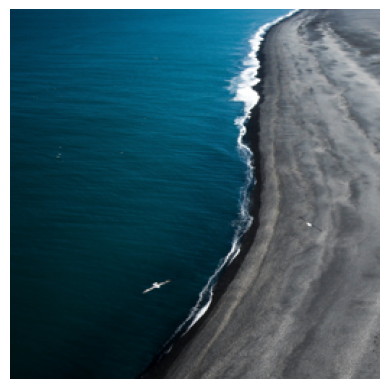

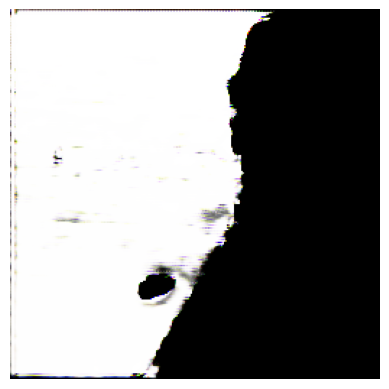

In [41]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf

image = Image.open('./MainDir/Untitled Folder/fedsam/fedsamv1/images/pexels-jeremy-bishop-2524874.jpg')
image = image.resize((256, 256))  # Resize the image to (256, 256)
image = np.array(image)
show_image(image)
plt.show()
pred_mask = UNet(tf.expand_dims(image,axis=0))[0]
show_image(pred_mask)
plt.show()

{'pixel_values': tensor([[[[-2.1008, -2.1008, -2.1008,  ...,  0.0056,  0.0056,  0.0056],
          [-2.1008, -2.1008, -2.1008,  ...,  0.0056,  0.0056,  0.0056],
          [-2.1008, -2.1008, -2.1008,  ...,  0.0227,  0.0227,  0.0227],
          ...,
          [-2.1008, -2.1008, -2.1008,  ..., -0.2171, -0.2171, -0.2171],
          [-2.1008, -2.1008, -2.1008,  ..., -0.2171, -0.2171, -0.2171],
          [-2.1008, -2.1008, -2.1008,  ..., -0.2171, -0.2171, -0.2171]],

         [[-1.0903, -1.0903, -1.0903,  ...,  0.3627,  0.3627,  0.3627],
          [-1.0903, -1.0903, -1.0903,  ...,  0.3627,  0.3627,  0.3627],
          [-1.0903, -1.0903, -1.0903,  ...,  0.3803,  0.3803,  0.3803],
          ...,
          [-1.7731, -1.7731, -1.7731,  ..., -0.0749, -0.0749, -0.0749],
          [-1.7731, -1.7731, -1.7731,  ..., -0.0749, -0.0749, -0.0749],
          [-1.7731, -1.7731, -1.7731,  ..., -0.0749, -0.0749, -0.0749]],

         [[-0.3927, -0.3927, -0.3927,  ...,  0.8274,  0.8274,  0.8274],
          [-0

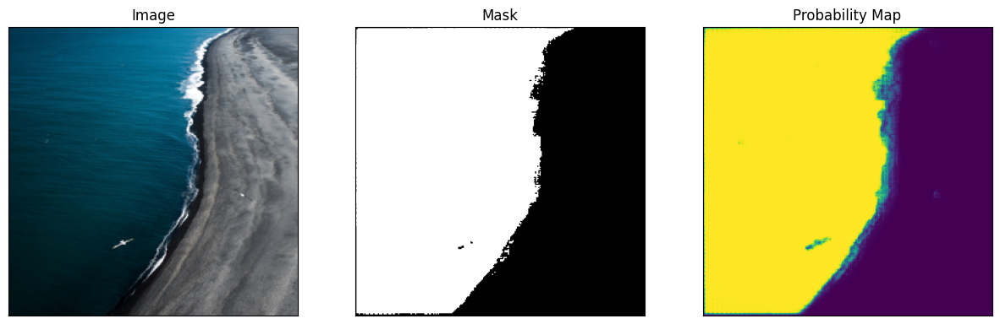

In [42]:
import numpy as np
import random
import torch
import matplotlib.pyplot as plt
from PIL import Image

# Load a normal image (you need to specify the path to your image)
# normal_image_path = "../images/w1.jpg"
# test_image = Image.open(normal_image_path)
# image = test_image.resize((256, 256))
# Get the box prompt based on the image size (you may need to adjust this based on your use case)
# prompt = [0, 0, test_image.width, test_image.height]
ground_truth_mask = np.array(pred_mask)

prompt = get_bounding_box(ground_truth_mask)

# Process image and bounding box with the processor
inputs = processor(images=image, input_boxes=[[prompt]], return_tensors="pt")
inputs = {k: v.cpu() for k, v in inputs.items()}
# inputs["ground_truth_mask"] = ground_truth_mask


# # Prepare the image + box prompt for the model
# inputs = processor(test_image, input_boxes=prompt, return_tensors="pt")

# # Move the input tensor to the GPU if it's not already there
# inputs = {k: v.to(device) for k, v in inputs.items()}

# Set the model to evaluation mode
sam_model.eval()
print(inputs)
# Forward pass
with torch.no_grad():
    outputs = sam_model(**inputs, multimask_output=False)

# Apply sigmoid
medsam_seg_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
# Convert soft mask to hard mask
medsam_seg_prob = medsam_seg_prob.cpu().numpy().squeeze()
medsam_seg = (medsam_seg_prob > 0.5).astype(np.uint8)

# Create a figure for plotting
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the original image on the left
axes[0].imshow(np.array(image), cmap='gray')
axes[0].set_title("Image")

# Plot the segmentation mask in the middle
axes[1].imshow(medsam_seg, cmap='gray')
axes[1].set_title("Mask")

# Plot the probability map on the right
axes[2].imshow(medsam_seg_prob, cmap='viridis')  # You can choose a different colormap
axes[2].set_title("Probability Map")

# Hide axis ticks and labels
for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xticklabels([])
    ax.set_yticklabels([])

# Display the images side by side
plt.show()
